In [394]:
import pandas as pd
from matplotlib import pyplot as plt
import missingno as msno

import numpy as np
import plotly.figure_factory as ff
import seaborn as sns
import plotly.graph_objects as go

import plotly.io as pio
# pio.renderers.default = 'notebook'

In [395]:
df = pd.read_csv("./data/my_example_data.csv")
df.head()

,Date,OXO-5FI635C Augusta,OXO-5FI661A Augusta,OXO-5FI696 Augusta,OXO-5FIC132 Augusta,OXO-5FIC600 Augusta,OXO-5FIC601 Augusta,OXO-5FIC602 Augusta,OXO-5FIC603 Augusta,OXO-5FIC606A Augusta,...,OXO-5TIC603 Augusta,OXO-5TIC604 Augusta,OXO-5TIC605 Augusta,OXO-5TIC606 Augusta,OXO-5TIC607 Augusta,OXO-5TIC659 Augusta,OXO-_5FI658A Augusta,OXO-_5FI659A Augusta,OXO-_5FI660A Augusta,OXO-_5FI662A Augusta
0,2019-11-01 00:00:00,5859.125648,23345.857389,9830.200195,4.450549,2076.174093,67.208298,5069.174366,0.0,NaN,...,133.996300,130.578919,133.007764,134.032267,130.899539,298.029910,21719.630615,22870.976318,22026.824772,22036.315560
1,2019-11-01 01:00:00,5950.173837,23346.553467,9384.632992,4.410112,2070.199284,67.204392,5068.014148,0.0,NaN,...,133.994588,130.640505,132.966600,134.035076,130.849780,298.084330,21727.622575,22879.205452,22042.948193,22056.644971
2,2019-11-01 02:00:00,6379.102250,23430.336545,9233.277262,4.285714,2067.933828,67.031974,5069.603650,0.0,NaN,...,134.008106,130.675602,133.035094,134.001994,130.743083,297.930878,21836.766659,22970.057215,22156.774258,22105.218684
3,2019-11-01 03:00:00,6337.343084,23384.694743,9223.139014,4.775281,2062.488529,66.808810,5061.608939,0.0,NaN,...,134.008312,130.613462,133.000552,133.979115,130.760757,298.052583,21783.450505,22920.952018,22088.356950,22064.178402
4,2019-11-01 04:00:00,6183.590302,23357.085677,9104.168620,4.388889,2055.162223,66.354369,5004.132636,0.0,NaN,...,134.002098,130.614549,133.004748,134.000492,130.814450,298.039928,21748.715137,22895.312126,22073.622298,22053.480892


In [396]:
df.columns

Index(['Date', 'OXO-5FI635C Augusta', 'OXO-5FI661A Augusta',
       'OXO-5FI696 Augusta', 'OXO-5FIC132 Augusta', 'OXO-5FIC600 Augusta',
       'OXO-5FIC601 Augusta', 'OXO-5FIC602 Augusta', 'OXO-5FIC603 Augusta',
       'OXO-5FIC606A Augusta', 'OXO-5FIC606C Augusta', 'OXO-5FIC607 Augusta',
       'OXO-5FIC609A Augusta', 'OXO-5FIC609B Augusta', 'OXO-5FIC611A Augusta',
       'OXO-5FIC611B Augusta', 'OXO-5FIC612A Augusta', 'OXO-5FIC612B Augusta',
       'OXO-5FIC618A Augusta', 'OXO-5FIC618B Augusta', 'OXO-5FIC618C Augusta',
       'OXO-5FIC618D Augusta', 'OXO-5FIC622A Augusta', 'OXO-5FIC622B Augusta',
       'OXO-5FIC622C Augusta', 'OXO-5FIC636A Augusta', 'OXO-5FIC636B Augusta',
       'OXO-5FIC636C Augusta', 'OXO-5FQI691B Augusta', 'OXO-5LI633B Augusta',
       'OXO-5LI650F Augusta', 'OXO-5LI651E Augusta', 'OXO-5LI651F Augusta',
       'OXO-5LI652E Augusta', 'OXO-5LI652F Augusta', 'OXO-5LI653E Augusta',
       'OXO-5LI653F Augusta', 'OXO-5LI654E Augusta', 'OXO-5LI654F Augusta',
       'O

In [397]:
columns = df.columns
target_list = []
for col in columns:
    for tag in ["5FI696", "5FIC612A", "5FIC612B", "5FIC600", "5FIC601"]:
        if tag in col:
            target_list.append(col)
target_list


['OXO-5FI696 Augusta',
 'OXO-5FIC600 Augusta',
 'OXO-5FIC601 Augusta',
 'OXO-5FIC612A Augusta',
 'OXO-5FIC612B Augusta']

In [398]:
df.shape

(28821, 60)

In [399]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 28821 entries, 0 to 28820
Data columns (total 60 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   Date                   28821 non-null  object 
 1   OXO-5FI635C Augusta    28171 non-null  float64
 2   OXO-5FI661A Augusta    28124 non-null  float64
 3   OXO-5FI696 Augusta     28124 non-null  float64
 4   OXO-5FIC132 Augusta    27956 non-null  float64
 5   OXO-5FIC600 Augusta    28149 non-null  float64
 6   OXO-5FIC601 Augusta    28147 non-null  float64
 7   OXO-5FIC602 Augusta    28148 non-null  float64
 8   OXO-5FIC603 Augusta    28147 non-null  float64
 9   OXO-5FIC606A Augusta   16413 non-null  float64
 10  OXO-5FIC606C Augusta   28149 non-null  float64
 11  OXO-5FIC607 Augusta    28123 non-null  float64
 12  OXO-5FIC609A Augusta   28123 non-null  float64
 13  OXO-5FIC609B Augusta   28148 non-null  float64
 14  OXO-5FIC611A Augusta   27883 non-null  float64
 15  OX

In [400]:
# Create a dictionary to map the category to each tag
tag_df = pd.read_excel('../data/SASOL_OXO_2023_Full_Tag_List.xlsx')
tag_dict = dict(zip(tag_df['Tag'], tag_df['Category']))
print(tag_dict)

{'T2.OXO.5FI635C Augusta': 'Measurement', 'T2.OXO.5FI661A Augusta': 'Measurement', 'T2.OXO.5FI696 Augusta': 'Independent', 'T2.OXO.5FIC132 Augusta': 'Independent', 'T2.OXO.5FIC600 Augusta': 'Target', 'T2.OXO.5FIC601 Augusta': 'Target', 'T2.OXO.5FIC602 Augusta': 'Control', 'T2.OXO.5FIC603 Augusta': 'Control', 'T2.OXO.5FIC606A Augusta': 'Control', 'T2.OXO.5FIC606C Augusta': 'Control', 'T2.OXO.5FIC607 Augusta': 'Control', 'T2.OXO.5FIC609A Augusta': 'Target', 'T2.OXO.5FIC609B Augusta': 'Control', 'T2.OXO.5FIC611A Augusta': 'Control', 'T2.OXO.5FIC611B Augusta': 'Control', 'T2.OXO.5FIC612A Augusta': 'Target', 'T2.OXO.5FIC612B Augusta': 'Target', 'T2.OXO.5FIC618A Augusta': 'Control', 'T2.OXO.5FIC618B Augusta': 'Control', 'T2.OXO.5FIC618C Augusta': 'Control', 'T2.OXO.5FIC618D Augusta': 'Control', 'T2.OXO.5FIC622A Augusta': 'Control', 'T2.OXO.5FIC622B Augusta': 'Control', 'T2.OXO.5FIC622C Augusta': 'Control', 'T2.OXO.5FIC636A Augusta': 'Control', 'T2.OXO.5FIC636B Augusta': 'Control', 'T2.OXO.5F

## Missing Values Processing<a name="clean"></a>

In [401]:
df.isnull().sum()

Date                         0
OXO-5FI635C Augusta        650
OXO-5FI661A Augusta        697
OXO-5FI696 Augusta         697
OXO-5FIC132 Augusta        865
OXO-5FIC600 Augusta        672
OXO-5FIC601 Augusta        674
OXO-5FIC602 Augusta        673
OXO-5FIC603 Augusta        674
OXO-5FIC606A Augusta     12408
OXO-5FIC606C Augusta       672
OXO-5FIC607 Augusta        698
OXO-5FIC609A Augusta       698
OXO-5FIC609B Augusta       673
OXO-5FIC611A Augusta       938
OXO-5FIC611B Augusta     12503
OXO-5FIC612A Augusta       673
OXO-5FIC612B Augusta       602
OXO-5FIC618A Augusta       577
OXO-5FIC618B Augusta       673
OXO-5FIC618C Augusta       914
OXO-5FIC618D Augusta       697
OXO-5FIC622A Augusta       698
OXO-5FIC622B Augusta       698
OXO-5FIC622C Augusta       673
OXO-5FIC636A Augusta       673
OXO-5FIC636B Augusta       650
OXO-5FIC636C Augusta       626
OXO-5FQI691B Augusta       650
OXO-5LI633B Augusta        625
OXO-5LI650F Augusta        697
OXO-5LI651E Augusta        649
OXO-5LI6

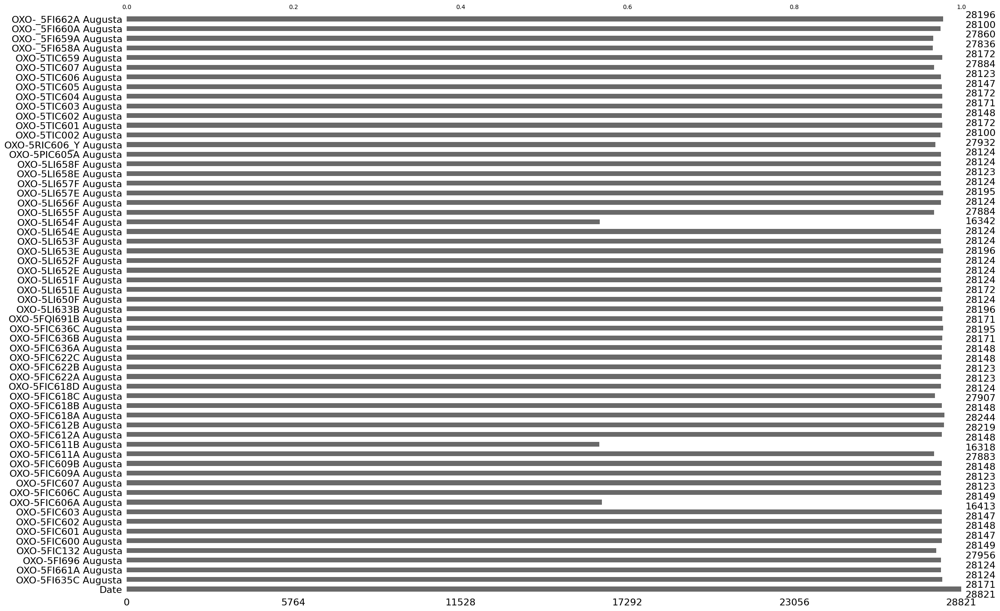

In [402]:
# Displaying a bar chart for the non-missing values of each column
msno.bar(df)
plt.show()

In [403]:
pd.isnull(df).sum()[pd.isnull(df).sum() / df.shape[0] > 0.4]

OXO-5FIC606A Augusta    12408
OXO-5FIC611B Augusta    12503
OXO-5LI654F Augusta     12479
dtype: int64

In [404]:
del_cols = [i for i in df.columns if df[i].isnull().sum() / df.shape[0] > 0.4]
print(del_cols)

['OXO-5FIC606A Augusta', 'OXO-5FIC611B Augusta', 'OXO-5LI654F Augusta']


In [405]:
# Check wether these three columns are our target columns
for col in del_cols:
    if col in target_list:
        print(col + " is in the target list")

In [406]:
# Check if there are deleted successfully
df.drop(columns=del_cols, inplace=True)
df.shape

(28821, 57)

In [407]:
pd.isnull(df).sum()[pd.isnull(df).sum() / df.shape[0] > 0.1]

Series([], dtype: int64)

In [408]:
# Fill the rest with missing values
fill_cols = [i for i in df.columns if df[i].isnull().sum()>0]
print(fill_cols)
print(len(fill_cols))

['OXO-5FI635C Augusta', 'OXO-5FI661A Augusta', 'OXO-5FI696 Augusta', 'OXO-5FIC132 Augusta', 'OXO-5FIC600 Augusta', 'OXO-5FIC601 Augusta', 'OXO-5FIC602 Augusta', 'OXO-5FIC603 Augusta', 'OXO-5FIC606C Augusta', 'OXO-5FIC607 Augusta', 'OXO-5FIC609A Augusta', 'OXO-5FIC609B Augusta', 'OXO-5FIC611A Augusta', 'OXO-5FIC612A Augusta', 'OXO-5FIC612B Augusta', 'OXO-5FIC618A Augusta', 'OXO-5FIC618B Augusta', 'OXO-5FIC618C Augusta', 'OXO-5FIC618D Augusta', 'OXO-5FIC622A Augusta', 'OXO-5FIC622B Augusta', 'OXO-5FIC622C Augusta', 'OXO-5FIC636A Augusta', 'OXO-5FIC636B Augusta', 'OXO-5FIC636C Augusta', 'OXO-5FQI691B Augusta', 'OXO-5LI633B Augusta', 'OXO-5LI650F Augusta', 'OXO-5LI651E Augusta', 'OXO-5LI651F Augusta', 'OXO-5LI652E Augusta', 'OXO-5LI652F Augusta', 'OXO-5LI653E Augusta', 'OXO-5LI653F Augusta', 'OXO-5LI654E Augusta', 'OXO-5LI655F Augusta', 'OXO-5LI656F Augusta', 'OXO-5LI657E Augusta', 'OXO-5LI657F Augusta', 'OXO-5LI658E Augusta', 'OXO-5LI658F Augusta', 'OXO-5PIC605A Augusta', 'OXO-5RIC606_Y A

In [409]:
# Check if there is still a column that has missing values
for j in fill_cols:
    df[j]=df[j].fillna(df[j].mean())

fill_cols = [i for i in df.columns if df[i].isnull().sum()>0]
print(fill_cols)

[]


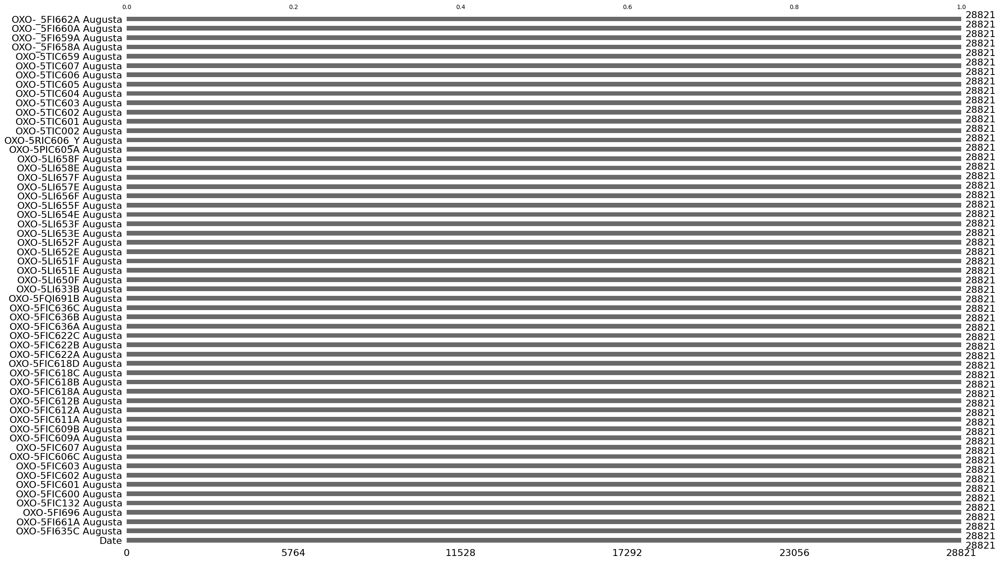

In [410]:
msno.bar(df)
plt.show()

## Correlation Analysis<a name="clean"></a>

In [411]:
df['Date'] = pd.to_datetime(df['Date'])
df.head()

,Date,OXO-5FI635C Augusta,OXO-5FI661A Augusta,OXO-5FI696 Augusta,OXO-5FIC132 Augusta,OXO-5FIC600 Augusta,OXO-5FIC601 Augusta,OXO-5FIC602 Augusta,OXO-5FIC603 Augusta,OXO-5FIC606C Augusta,...,OXO-5TIC603 Augusta,OXO-5TIC604 Augusta,OXO-5TIC605 Augusta,OXO-5TIC606 Augusta,OXO-5TIC607 Augusta,OXO-5TIC659 Augusta,OXO-_5FI658A Augusta,OXO-_5FI659A Augusta,OXO-_5FI660A Augusta,OXO-_5FI662A Augusta
0,2019-11-01 00:00:00,5859.125648,23345.857389,9830.200195,4.450549,2076.174093,67.208298,5069.174366,0.0,1.202029,...,133.996300,130.578919,133.007764,134.032267,130.899539,298.029910,21719.630615,22870.976318,22026.824772,22036.315560
1,2019-11-01 01:00:00,5950.173837,23346.553467,9384.632992,4.410112,2070.199284,67.204392,5068.014148,0.0,1.158160,...,133.994588,130.640505,132.966600,134.035076,130.849780,298.084330,21727.622575,22879.205452,22042.948193,22056.644971
2,2019-11-01 02:00:00,6379.102250,23430.336545,9233.277262,4.285714,2067.933828,67.031974,5069.603650,0.0,1.070420,...,134.008106,130.675602,133.035094,134.001994,130.743083,297.930878,21836.766659,22970.057215,22156.774258,22105.218684
3,2019-11-01 03:00:00,6337.343084,23384.694743,9223.139014,4.775281,2062.488529,66.808810,5061.608939,0.0,1.044098,...,134.008312,130.613462,133.000552,133.979115,130.760757,298.052583,21783.450505,22920.952018,22088.356950,22064.178402
4,2019-11-01 04:00:00,6183.590302,23357.085677,9104.168620,4.388889,2055.162223,66.354369,5004.132636,0.0,1.044098,...,134.002098,130.614549,133.004748,134.000492,130.814450,298.039928,21748.715137,22895.312126,22073.622298,22053.480892


In [412]:
# Move target columns to front
cols_to_move = ['Date'] + target_list
df = df[cols_to_move + [x for x in df.columns if x not in cols_to_move]]
df.head()

,Date,OXO-5FI696 Augusta,OXO-5FIC600 Augusta,OXO-5FIC601 Augusta,OXO-5FIC612A Augusta,OXO-5FIC612B Augusta,OXO-5FI635C Augusta,OXO-5FI661A Augusta,OXO-5FIC132 Augusta,OXO-5FIC602 Augusta,...,OXO-5TIC603 Augusta,OXO-5TIC604 Augusta,OXO-5TIC605 Augusta,OXO-5TIC606 Augusta,OXO-5TIC607 Augusta,OXO-5TIC659 Augusta,OXO-_5FI658A Augusta,OXO-_5FI659A Augusta,OXO-_5FI660A Augusta,OXO-_5FI662A Augusta
0,2019-11-01 00:00:00,9830.200195,2076.174093,67.208298,0.009363,8.997839,5859.125648,23345.857389,4.450549,5069.174366,...,133.996300,130.578919,133.007764,134.032267,130.899539,298.029910,21719.630615,22870.976318,22026.824772,22036.315560
1,2019-11-01 01:00:00,9384.632992,2070.199284,67.204392,0.008853,9.000415,5950.173837,23346.553467,4.410112,5068.014148,...,133.994588,130.640505,132.966600,134.035076,130.849780,298.084330,21727.622575,22879.205452,22042.948193,22056.644971
2,2019-11-01 02:00:00,9233.277262,2067.933828,67.031974,0.009193,8.999083,6379.102250,23430.336545,4.285714,5069.603650,...,134.008106,130.675602,133.035094,134.001994,130.743083,297.930878,21836.766659,22970.057215,22156.774258,22105.218684
3,2019-11-01 03:00:00,9223.139014,2062.488529,66.808810,0.009306,8.997776,6337.343084,23384.694743,4.775281,5061.608939,...,134.008312,130.613462,133.000552,133.979115,130.760757,298.052583,21783.450505,22920.952018,22088.356950,22064.178402
4,2019-11-01 04:00:00,9104.168620,2055.162223,66.354369,0.009023,8.998597,6183.590302,23357.085677,4.388889,5004.132636,...,134.002098,130.614549,133.004748,134.000492,130.814450,298.039928,21748.715137,22895.312126,22073.622298,22053.480892


In [413]:
df_corr = df.iloc[:, 1:].corr() # Generate correlation matrix

# By default, corr() calculates the Pearson correlation coefficient between each pair of columns.
# The Pearson correlation coefficient is a measure of the linear relationship between two variables. 
# It ranges from -1 to 1, where -1 indicates a perfect negative correlation, 0 indicates no correlation, and 1 indicates a perfect positive correlation.

fig = go.Figure()
fig.add_trace(go.Heatmap(x=df_corr.columns, y=df_corr.index, z=np.array(df_corr)))
fig.update_layout(
    width=1200,
    height=1200
)
fig.write_html("./image/corr_heatmap.html")
fig.show()

Pairs of highly correlated features:
('OXO-5FIC612A Augusta', 'OXO-5FIC609A Augusta')
('OXO-5FIC612B Augusta', 'OXO-5FIC609B Augusta')
('OXO-5FI661A Augusta', 'OXO-_5FI660A Augusta')
('OXO-5FI661A Augusta', 'OXO-_5FI662A Augusta')
('OXO-5LI651E Augusta', 'OXO-5LI651F Augusta')
('OXO-5LI652E Augusta', 'OXO-5LI652F Augusta')
('OXO-5LI653E Augusta', 'OXO-5LI653F Augusta')
('OXO-5TIC602 Augusta', 'OXO-5TIC603 Augusta')
('OXO-5TIC602 Augusta', 'OXO-5TIC604 Augusta')
('OXO-5TIC602 Augusta', 'OXO-5TIC605 Augusta')
('OXO-5TIC602 Augusta', 'OXO-5TIC607 Augusta')
('OXO-5TIC603 Augusta', 'OXO-5TIC604 Augusta')
('OXO-5TIC603 Augusta', 'OXO-5TIC605 Augusta')
('OXO-5TIC603 Augusta', 'OXO-5TIC606 Augusta')
('OXO-5TIC604 Augusta', 'OXO-5TIC605 Augusta')
('OXO-5TIC604 Augusta', 'OXO-5TIC606 Augusta')
('OXO-5TIC604 Augusta', 'OXO-5TIC607 Augusta')
('OXO-5TIC605 Augusta', 'OXO-5TIC606 Augusta')
('OXO-5TIC605 Augusta', 'OXO-5TIC607 Augusta')
('OXO-5TIC606 Augusta', 'OXO-5TIC607 Augusta')
('OXO-_5FI659A Au

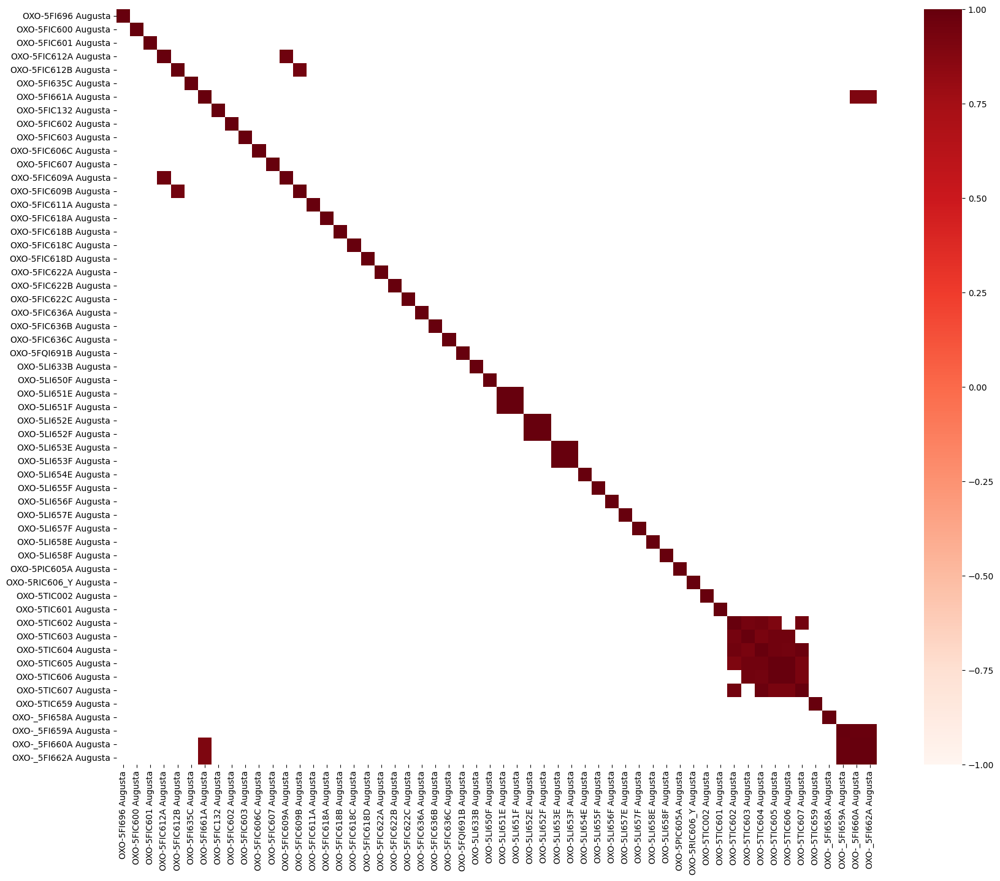

In [414]:
# Define a threshold for high correlation
threshold = 0.9

# Extract pairs of highly correlated features
high_corr_pairs = []
for i in range(len(df_corr.columns)):
    for j in range(i+1, len(df_corr.columns)):
        if abs(df_corr.iloc[i, j]) > threshold:
            high_corr_pairs.append((df_corr.columns[i], df_corr.columns[j]))

# Print the highly correlated feature pairs
print("Pairs of highly correlated features:")
for pair in high_corr_pairs:
    print(pair)

fig = plt.subplots(figsize=(20, 16))

sns.heatmap(df_corr[df_corr>0.9], vmax=1, vmin=-1, center=0, cmap = 'Reds')
plt.savefig("./image/corr_matrix.png", dpi=300)
plt.show()

In [415]:
# Drop highly correlated columns
drop_cols = ['OXO-5FIC609A Augusta',
                      'OXO-5FIC609B Augusta', 
                      'OXO-5FI661A Augusta',
                      'OXO-5LI651E Augusta',
                      'OXO-5LI652E Augusta',
                      'OXO-5LI653E Augusta',
                      'OXO-5TIC602 Augusta',
                      'OXO-5TIC603 Augusta',
                      'OXO-5TIC604 Augusta',
                      'OXO-5TIC605 Augusta',
                      'OXO-5TIC606 Augusta',
                      'OXO-5TIC607 Augusta',
                      'OXO-_5FI659A Augusta',
                      'OXO-_5FI660A Augusta',
                      'OXO-_5FI662A Augusta']

# If the Category lable of that tag is 'Control', we don't drop it
for col in drop_cols:
    col_origin = col.replace('OXO-', 'T2.OXO.')
    if  tag_dict[col_origin] == 'Control':
        drop_cols.remove(col)

drop_cols

['OXO-5FIC609A Augusta',
 'OXO-5FI661A Augusta',
 'OXO-5LI651E Augusta',
 'OXO-5LI652E Augusta',
 'OXO-5LI653E Augusta',
 'OXO-5TIC603 Augusta',
 'OXO-5TIC605 Augusta',
 'OXO-5TIC607 Augusta',
 'OXO-_5FI659A Augusta',
 'OXO-_5FI660A Augusta',
 'OXO-_5FI662A Augusta']

In [416]:
df = df.drop(columns=drop_cols)
df.head()

,Date,OXO-5FI696 Augusta,OXO-5FIC600 Augusta,OXO-5FIC601 Augusta,OXO-5FIC612A Augusta,OXO-5FIC612B Augusta,OXO-5FI635C Augusta,OXO-5FIC132 Augusta,OXO-5FIC602 Augusta,OXO-5FIC603 Augusta,...,OXO-5LI658F Augusta,OXO-5PIC605A Augusta,OXO-5RIC606_Y Augusta,OXO-5TIC002 Augusta,OXO-5TIC601 Augusta,OXO-5TIC602 Augusta,OXO-5TIC604 Augusta,OXO-5TIC606 Augusta,OXO-5TIC659 Augusta,OXO-_5FI658A Augusta
0,2019-11-01 00:00:00,9830.200195,2076.174093,67.208298,0.009363,8.997839,5859.125648,4.450549,5069.174366,0.0,...,5676.722192,184.026887,0.199966,298.013262,154.952728,132.091821,130.578919,134.032267,298.029910,21719.630615
1,2019-11-01 01:00:00,9384.632992,2070.199284,67.204392,0.008853,9.000415,5950.173837,4.410112,5068.014148,0.0,...,5658.071919,183.953295,0.199927,297.987793,155.027598,132.063896,130.640505,134.035076,298.084330,21727.622575
2,2019-11-01 02:00:00,9233.277262,2067.933828,67.031974,0.009193,8.999083,6379.102250,4.285714,5069.603650,0.0,...,5654.247091,183.963430,0.199966,298.040944,155.070804,132.035482,130.675602,134.001994,297.930878,21836.766659
3,2019-11-01 03:00:00,9223.139014,2062.488529,66.808810,0.009306,8.997776,6337.343084,4.775281,5061.608939,0.0,...,5636.469763,183.975388,0.200009,297.962240,154.915349,132.028896,130.613462,133.979115,298.052583,21783.450505
4,2019-11-01 04:00:00,9104.168620,2055.162223,66.354369,0.009023,8.998597,6183.590302,4.388889,5004.132636,0.0,...,5616.930511,183.968712,0.199948,298.029856,155.040506,132.070333,130.614549,134.000492,298.039928,21748.715137


In [417]:
df.shape

(28821, 46)

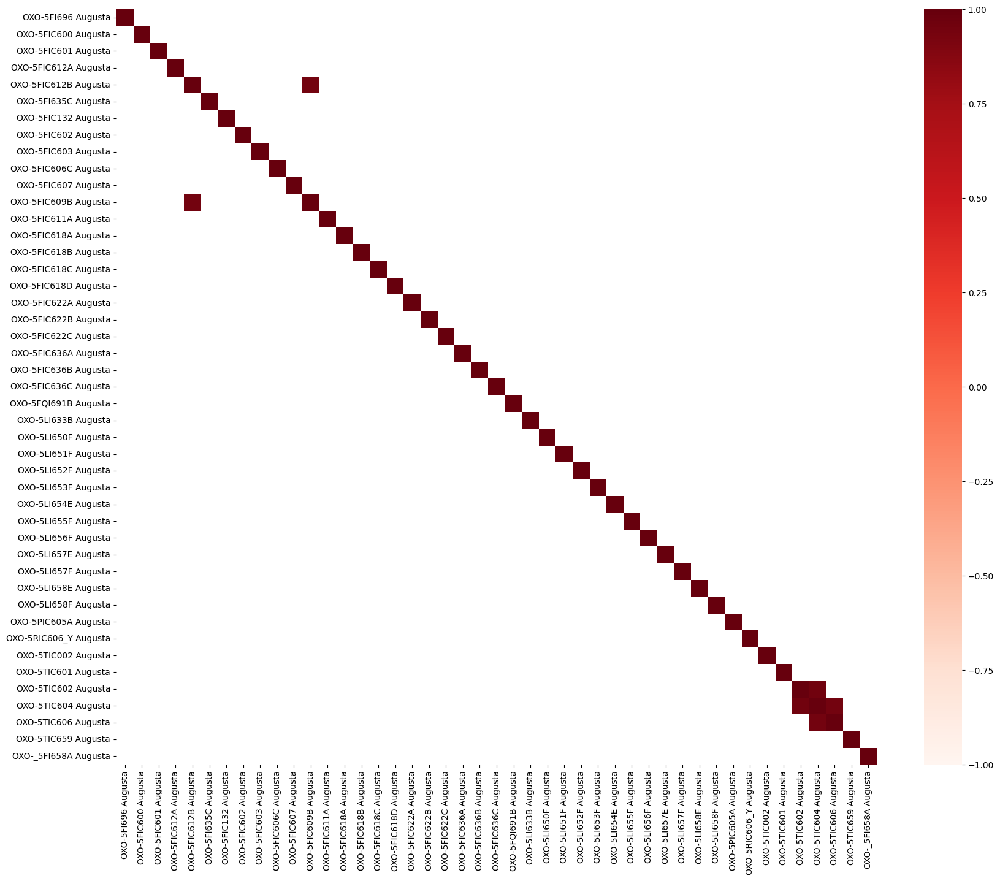

In [418]:
fig = plt.subplots(figsize=(20, 16))
corr = df.iloc[:, 1:].corr()
sns.heatmap(corr[corr>0.9], vmax=1, vmin=-1, center=0, cmap = 'Reds')
plt.show()

In [419]:
# from BorutaShap import BorutaShap
# # from sklearn.datasets import load_boston

# X = df.drop(columns=['OXO-5FI696 Augusta'])
# # input_columns = df.loc[:, df.columns != "class"]
# y = df['OXO-5FI696 Augusta']

# Feature_Selector = BorutaShap(importance_measure='shap', classification=False)
# Feature_Selector.fit(X=X, y=y, n_trials=100, random_state=0)

# # Check selected features
# print(Feature_Selector.Subset())

## Target Variables Distribution<a name="clean"></a>

In [420]:
import plotly.express as px

fig = px.line(df, x='Date', y=target_list)
fig.update_layout(
    width=1200,
    height=600
)
fig.write_html("./image/target_variables.html")
fig.show()

Output: OXO-5FI696 Augusta

In [421]:
# Check the output, 'OXO-5FI696 Augusta', when it drop down to 0
# Focus on the last three variables

fig = px.line(df, x='Date', y=target_list[0])
fig.update_layout(
    width=1200,
    height=600,
    yaxis=dict(range=[0, 10])
)
# fig.write_html("./image/target_variables.html")
fig.show()

In [422]:
# find indices where value goes below the threshold

threshold = 2000

zero_indices = df[df['OXO-5FI696 Augusta'] < threshold].index
print(zero_indices.shape)

# output timestamps
# for index in zero_indices:
#     print(df['Date'][index])

# delete rows
df.drop(df.index[zero_indices], inplace=True)

(2092,)


In [423]:
df.shape

(26729, 46)

In [424]:
# Check if rows are deleted successfully
df.loc[(df['Date'] >= '2021-03-06') & (df['Date'] < '2021-03-07')]

,Date,OXO-5FI696 Augusta,OXO-5FIC600 Augusta,OXO-5FIC601 Augusta,OXO-5FIC612A Augusta,OXO-5FIC612B Augusta,OXO-5FI635C Augusta,OXO-5FIC132 Augusta,OXO-5FIC602 Augusta,OXO-5FIC603 Augusta,...,OXO-5LI658F Augusta,OXO-5PIC605A Augusta,OXO-5RIC606_Y Augusta,OXO-5TIC002 Augusta,OXO-5TIC601 Augusta,OXO-5TIC602 Augusta,OXO-5TIC604 Augusta,OXO-5TIC606 Augusta,OXO-5TIC659 Augusta,OXO-_5FI658A Augusta


In [425]:
target_list

['OXO-5FI696 Augusta',
 'OXO-5FIC600 Augusta',
 'OXO-5FIC601 Augusta',
 'OXO-5FIC612A Augusta',
 'OXO-5FIC612B Augusta']

'OXO-5FIC601 Augusta', 'OXO-5FIC612A Augusta' and 'OXO-5FIC612B Augusta'

In [426]:
# Focus on the last three variables

fig = px.line(df, x='Date', y=target_list[2:5])
fig.update_layout(
    width=1200,
    height=600
)
# fig.write_html("./image/target_variables.html")
fig.show()

'OXO-5FIC612A Augusta' and 'OXO-5FIC612B Augusta'

In [427]:
# Focus on the last two variables

fig = px.line(df, x='Date', y=target_list[3:5])
fig.update_layout(
    width=1200,
    height=600
)
# fig.write_html("./image/target_variables.html")
fig.show()

In [428]:
target_list

['OXO-5FI696 Augusta',
 'OXO-5FIC600 Augusta',
 'OXO-5FIC601 Augusta',
 'OXO-5FIC612A Augusta',
 'OXO-5FIC612B Augusta']

KPI1 Variation

In [429]:
# Let's check KPI1
kpi = df[target_list[0]] / ((df[target_list[3]] + df[target_list[4]])*1000 + df[target_list[1]] + df[target_list[2]])

fig = px.line(df, x='Date', y=kpi)
fig.update_layout(
    width=1200,
    height=600
)
# fig.write_html("./image/target_variables.html")
fig.show()

In [430]:
# View the value between 0 and 1.5
kpi = df[target_list[0]] / ((df[target_list[3]] + df[target_list[4]])*1000 + df[target_list[1]] + df[target_list[2]])

fig = px.line(df, x='Date', y=kpi)
fig.update_layout(
    width=1200,
    height=600,
    yaxis=dict(range=[0, 1.5])
)
# fig.update_layout(height=600, bargap=0.2,
#     margin=dict(b=50,r=30,l=100),
#     title = "<span style='font-size:36px; font-family:Times New Roman'>Feature Pattern</span>", 
#     plot_bgcolor='rgb(242,242,242)',
#     paper_bgcolor = 'rgb(242,242,242)',
#     font=dict(family="Times New Roman", size= 14),
#     hoverlabel=dict(font_color="floralwhite"),
#     showlegend=False)
# fig.write_html("./image/target_variables.html")
fig.show()

## Variance Analysis<a name="clean"></a>

In [431]:
std = df.iloc[:,1:].std()
std.shape

(45,)

In [432]:
std

OXO-5FI696 Augusta         2010.203238
OXO-5FIC600 Augusta         337.992069
OXO-5FIC601 Augusta          18.978467
OXO-5FIC612A Augusta          3.585469
OXO-5FIC612B Augusta          3.211522
OXO-5FI635C Augusta        2183.268673
OXO-5FIC132 Augusta        3188.641583
OXO-5FIC602 Augusta        2601.929246
OXO-5FIC603 Augusta        2754.924526
OXO-5FIC606C Augusta        667.535955
OXO-5FIC607 Augusta         793.304465
OXO-5FIC609B Augusta        910.206994
OXO-5FIC611A Augusta       3264.440598
OXO-5FIC618A Augusta       1827.781219
OXO-5FIC618B Augusta       1326.351066
OXO-5FIC618C Augusta       1208.854485
OXO-5FIC618D Augusta       1087.566838
OXO-5FIC622A Augusta        974.764032
OXO-5FIC622B Augusta        757.150839
OXO-5FIC622C Augusta        843.151979
OXO-5FIC636A Augusta       3203.431884
OXO-5FIC636B Augusta       3600.353058
OXO-5FIC636C Augusta       1166.765576
OXO-5FQI691B Augusta     167423.360616
OXO-5LI633B Augusta        1922.678428
OXO-5LI650F Augusta      

In [433]:
fig = go.Figure(data=[go.Bar(x=df.columns[1:], y=std)])
fig.update_layout(
    width=1200,
    height=600
)
fig.show()

In [434]:
# Take a look at that weird tag

fig = px.line(df, x='Date', y='OXO-5FQI691B Augusta')
fig.update_layout(
    width=1200,
    height=600
)
# fig.write_html("./image/target_variables.html")
fig.show()

In [435]:
# It's because the magnitude of the values in that column are large
# Let's try normalized std

norm_std = df.iloc[:,1:].std(ddof=0) / df.iloc[:,1:].mean()
norm_std

OXO-5FI696 Augusta        0.199036
OXO-5FIC600 Augusta       0.161540
OXO-5FIC601 Augusta       0.255115
OXO-5FIC612A Augusta      1.171391
OXO-5FIC612B Augusta      0.488540
OXO-5FI635C Augusta       0.361050
OXO-5FIC132 Augusta       0.978944
OXO-5FIC602 Augusta       0.639441
OXO-5FIC603 Augusta       0.760676
OXO-5FIC606C Augusta      0.868043
OXO-5FIC607 Augusta       1.169432
OXO-5FIC609B Augusta      0.492991
OXO-5FIC611A Augusta      1.430228
OXO-5FIC618A Augusta      1.044602
OXO-5FIC618B Augusta      0.427323
OXO-5FIC618C Augusta      0.296134
OXO-5FIC618D Augusta      0.356111
OXO-5FIC622A Augusta      1.145842
OXO-5FIC622B Augusta      0.349355
OXO-5FIC622C Augusta      0.370327
OXO-5FIC636A Augusta      0.840682
OXO-5FIC636B Augusta      0.917647
OXO-5FIC636C Augusta      0.691949
OXO-5FQI691B Augusta      0.522542
OXO-5LI633B Augusta       0.864952
OXO-5LI650F Augusta       0.936983
OXO-5LI651F Augusta       0.819886
OXO-5LI652F Augusta       0.853961
OXO-5LI653F Augusta 

In [436]:
fig = go.Figure(data=[go.Bar(x=df.columns[1:], y=norm_std)])
fig.update_layout(
    width=1200,
    height=600
)
fig.show()

In [437]:
# Take a look at that weird tag

fig = px.line(df, x='Date', y='OXO-5RIC606_Y Augusta')
fig.update_layout(
    width=1200,
    height=600
)
# fig.write_html("./image/target_variables.html")
fig.show()

In [438]:
# Take a look at that weird tag

fig = px.line(df, x='Date', y='OXO-5RIC606_Y Augusta')
fig.update_layout(
    width=1200,
    height=600,
    yaxis=dict(range=[0, 6])
)
# fig.write_html("./image/target_variables.html")
fig.show()

That column has lots of spikes, and also remain in 0 for a long time, so we decided to drop it.

In [439]:
df = df.drop(columns=['OXO-5RIC606_Y Augusta'])
df.shape

(26729, 45)

In [440]:
# Check for extremely small variance

small_std = [x for x in norm_std if x < 0.1]
small_std

[0.07191153291172453, 0.04192147743512893, 0.05077747524175793]

There is no column with extremely small variance

## Anomaly Detection<a name="clean"></a>

In [441]:
import plotly.graph_objects as go

# Create a box plot with outliers highlighted
fig = go.Figure()
fig.add_trace(go.Box(y=df[target_list[0]], boxpoints='outliers'))
fig.show()

In [442]:
from sklearn.metrics import r2_score, median_absolute_error, mean_absolute_error
from sklearn.metrics import median_absolute_error, mean_squared_error, mean_squared_log_error

def mean_absolute_percentage_error(y_true, y_pred): 
    return np.mean(np.abs((y_true - y_pred) / y_true)) * 100


def plotMovingAverage(series, window, plot_intervals=False, scale=1.96, plot_anomalies=False):

    """
        series - dataframe with timeseries
        window - rolling window size 
        plot_intervals - show confidence intervals
        plot_anomalies - show anomalies 
    """
    
    rolling_mean = series.rolling(window=window).mean()

    plt.figure(figsize=(25,10))
    plt.title("Anomaly Detection: Moving average with window size = {}".format(window))
    plt.plot(rolling_mean, "g", label="Rolling mean trend")

    # Plot confidence intervals for smoothed values
    if plot_intervals:
        mae = mean_absolute_error(series[window:], rolling_mean[window:])
        deviation = np.std(series[window:] - rolling_mean[window:])
        lower_bond = rolling_mean - (mae + scale * deviation)
        upper_bond = rolling_mean + (mae + scale * deviation)
        plt.plot(upper_bond, "r--", label="Upper Bond / Lower Bond")
        plt.plot(lower_bond, "r--")
        
        # Having the intervals, find abnormal values
        if plot_anomalies:
            anomalies = pd.DataFrame(index=series.index, columns=series.columns)
            anomalies[series<lower_bond] = series[series<lower_bond]
            anomalies[series>upper_bond] = series[series>upper_bond]
            plt.plot(anomalies, "ro", markersize=10)
        
    plt.plot(series[window:], label="Actual values")
    plt.legend(loc="upper left")
    plt.grid(True)


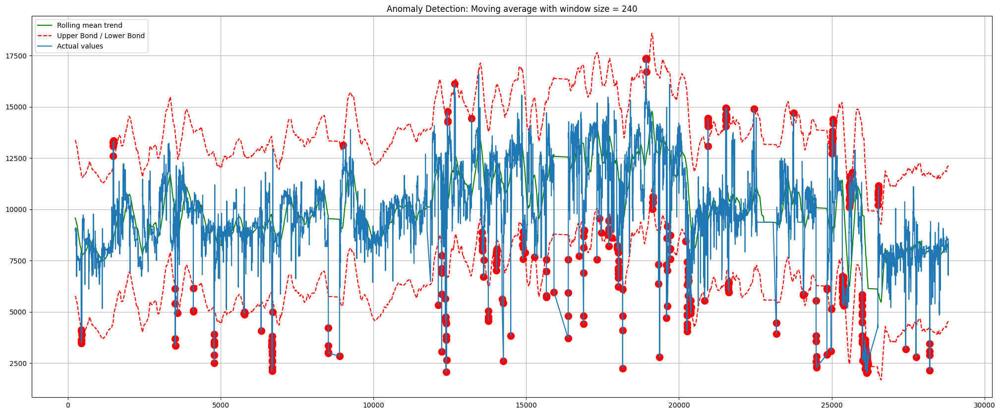

In [443]:
plotMovingAverage(df[target_list[0]].to_frame(), window=24*10, plot_intervals=True, plot_anomalies=True)

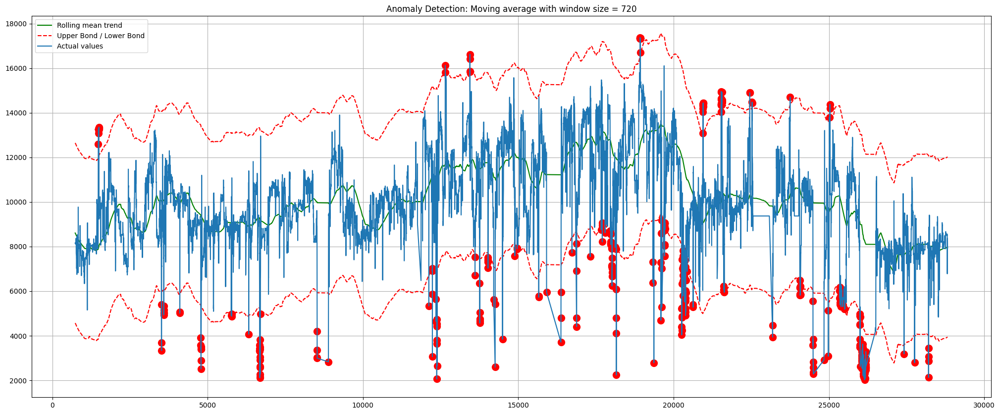

In [444]:
plotMovingAverage(df[target_list[0]].to_frame(), window=24*30, plot_intervals=True, plot_anomalies=True)


In [445]:
target_list

['OXO-5FI696 Augusta',
 'OXO-5FIC600 Augusta',
 'OXO-5FIC601 Augusta',
 'OXO-5FIC612A Augusta',
 'OXO-5FIC612B Augusta']

It seems there are lots of anomolies in 'OXO-5FI696 Augusta'

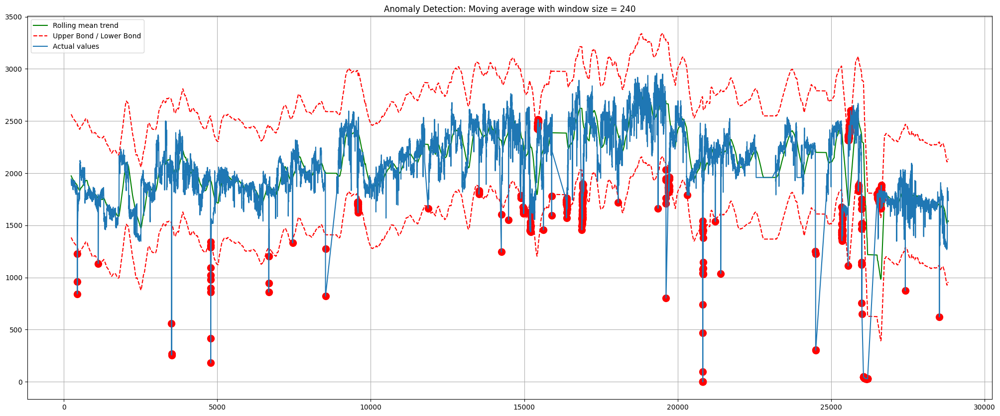

In [446]:
plotMovingAverage(df[target_list[1]].to_frame(), window=24*10, plot_intervals=True, plot_anomalies=True)

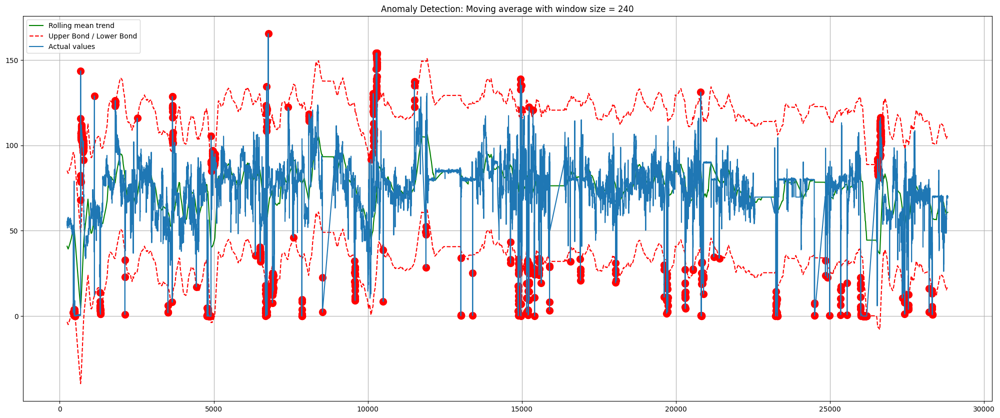

In [447]:
plotMovingAverage(df[target_list[2]].to_frame(), window=24*10, plot_intervals=True, plot_anomalies=True)

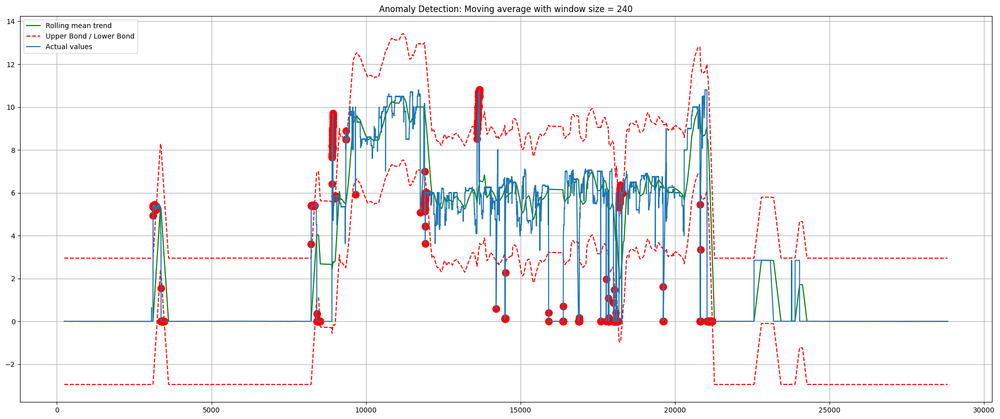

In [448]:
plotMovingAverage(df[target_list[3]].to_frame(), window=24*10, plot_intervals=True, plot_anomalies=True)

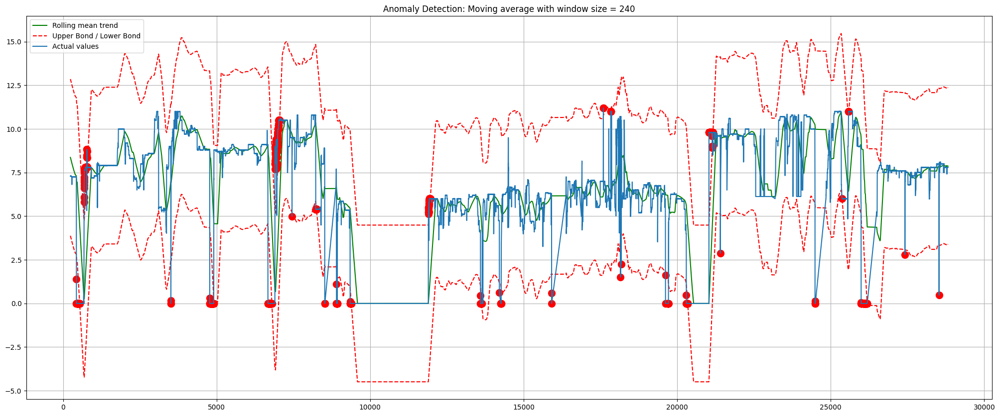

In [449]:
plotMovingAverage(df[target_list[4]].to_frame(), window=24*10, plot_intervals=True, plot_anomalies=True)

## ML Model<a name="clean"></a>

### LSTM

#### TimeStemp = 3

Data Preparation

In [450]:
df.shape

(26729, 45)

In [451]:
X = df.drop(columns=['Date', 'OXO-5FI696 Augusta'])
y = df['OXO-5FI696 Augusta']

In [452]:
# convert series to supervised learning
def series_to_supervised(data, n_in=1, n_out=1, dropnan=True):
	n_vars = 1 if type(data) is list else data.shape[1]
	df = pd.DataFrame(data)
	cols, names = list(), list()
	# input sequence (t-n, ... t-1)
	for i in range(n_in, 0, -1):
		cols.append(df.shift(i))
		names += [('var%d(t-%d)' % (j+1, i)) for j in range(n_vars)]
	# forecast sequence (t, t+1, ... t+n)
	for i in range(0, n_out):
		cols.append(df.shift(-i))
		if i == 0:
			names += [('var%d(t)' % (j+1)) for j in range(n_vars)]
		else:
			names += [('var%d(t+%d)' % (j+1, i)) for j in range(n_vars)]
	# put it all together
	agg = pd.concat(cols, axis=1)
	agg.columns = names
	# drop rows with NaN values
	if dropnan:
		agg.dropna(inplace=True)
	return agg

In [527]:
from sklearn.preprocessing import MinMaxScaler

# load dataset
df_2 = df.set_index('Date')
# print(df_2.head())
# print(df_2.columns)
values = df_2.values

# ensure all data is float
values = values.astype('float32')
print(values.shape)

# normalize features
scaler = MinMaxScaler(feature_range=(0, 1))
scaled = scaler.fit_transform(values)
# print(scaled.shape)

# frame as supervised learning
timesteps = 3
# print(df_2.columns[-44])
reframed = series_to_supervised(scaled, timesteps, 1)

print(reframed.head())
print(reframed.shape)

(26729, 44)
   var1(t-3)  var2(t-3)  var3(t-3)  var4(t-3)  var5(t-3)  var6(t-3)   
3   0.509042   0.702033   0.406147   0.000866   0.803311   0.689309  \
4   0.480015   0.700013   0.406123   0.000819   0.803541   0.700020   
5   0.470154   0.699247   0.405081   0.000851   0.803422   0.750483   
6   0.469494   0.697406   0.403733   0.000861   0.803305   0.745570   
7   0.461743   0.694929   0.400987   0.000835   0.803378   0.727481   

   var7(t-3)  var8(t-3)  var9(t-3)  var10(t-3)  ...  var35(t)  var36(t)   
3   0.000556   0.517453        0.0    0.000538  ...  0.912643  0.563647  \
4   0.000551   0.517334        0.0    0.000518  ...  0.912483  0.561693   
5   0.000536   0.517496        0.0    0.000479  ...  0.912314  0.559728   
6   0.000597   0.516680        0.0    0.000467  ...  0.912033  0.560978   
7   0.000549   0.510813        0.0    0.000467  ...  0.911851  0.570396   

   var37(t)  var38(t)  var39(t)  var40(t)  var41(t)  var42(t)  var43(t)   
3  0.934788  0.955428  0.805086  0.

In [528]:
# split into train and test sets
values = reframed.values

train_size = int(0.8 * len(df))
val_size = int(0.1 * len(df))
test_size = len(df) - train_size - val_size

train = values[:train_size, :]
val = values[train_size: train_size + val_size, :]
test = values[-test_size:, :]
# split into input and outputs
# with timesteps=3, we train on var1(t-3) - var44(t-3), var1(t-2) - var44(t-2), var1(t-1) - var44(t-1) to test var1(t)
n_features = 44
n_obs = timesteps * n_features
train_X, train_y = train[:, :n_obs], train[:, -n_features]
val_X, val_y = val[:, :n_obs], val[:, -n_features]
test_X, test_y = test[:, :n_obs], test[:, -n_features]

# reshape input to be 3D [samples, timesteps, features]
train_X = train_X.reshape((train_X.shape[0], timesteps, n_features))
val_X = val_X.reshape((val_X.shape[0], timesteps, n_features))
test_X = test_X.reshape((test_X.shape[0], timesteps, n_features))
print(train_X.shape, train_y.shape, test_X.shape, test_y.shape)

(21383, 3, 44) (21383,) (2674, 3, 44) (2674,)


Train

In [529]:
from tensorflow import keras
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Dropout
from tensorflow.keras.layers import LSTM
from tensorflow.keras import regularizers
keras.__version__
from sklearn.metrics import mean_squared_error,r2_score

In [530]:
model = Sequential()
# model.add(LSTM(units=32, activation='relu', input_shape=(x_train.shape[1], x_train.shape[2])))

model.add(LSTM(units=32, return_sequences=False, input_shape=(train_X.shape[1], train_X.shape[2]), kernel_regularizer=regularizers.l2(0.001), recurrent_regularizer=regularizers.l2(0.001)))
# model.add(LSTM(units=32, return_sequences=False, input_shape=(train_X.shape[1], train_X.shape[2]), kernel_regularizer=regularizers.l2(0.001), recurrent_regularizer=regularizers.l2(0.001), dropout=0.2, recurrent_dropout=0.2))
# model.add(LSTM(units=32, kernel_regularizer=regularizers.l2(0.001), recurrent_regularizer=regularizers.l2(0.001), dropout=0.2, recurrent_dropout=0.2))

# model.add(Dropout(0.2))
model.add(Dense(units = 1))

optimizer = keras.optimizers.Adam(lr=0.01)
# model.compile(optimizer = 'adam', loss = 'mean_squared_error')
model.compile(optimizer = optimizer, loss = 'mae')
model.summary()


Model: "sequential_20"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_19 (LSTM)              (None, 32)                9856      
                                                                 
 dense_18 (Dense)            (None, 1)                 33        
                                                                 
Total params: 9,889
Trainable params: 9,889
Non-trainable params: 0
_________________________________________________________________


Epoch 1/16
669/669 [==============================] - 7s 5ms/step - loss: 0.1250 - val_loss: 0.1298
Epoch 2/16
669/669 [==============================] - 3s 4ms/step - loss: 0.0893 - val_loss: 0.0835
Epoch 3/16
669/669 [==============================] - 3s 4ms/step - loss: 0.0752 - val_loss: 0.0586
Epoch 4/16
669/669 [==============================] - 3s 4ms/step - loss: 0.0664 - val_loss: 0.0511
Epoch 5/16
669/669 [==============================] - 2s 4ms/step - loss: 0.0623 - val_loss: 0.0484
Epoch 6/16
669/669 [==============================] - 3s 4ms/step - loss: 0.0594 - val_loss: 0.0457
Epoch 7/16
669/669 [==============================] - 3s 4ms/step - loss: 0.0565 - val_loss: 0.0409
Epoch 8/16
669/669 [==============================] - 3s 4ms/step - loss: 0.0539 - val_loss: 0.0416
Epoch 9/16
669/669 [==============================] - 3s 4ms/step - loss: 0.0525 - val_loss: 0.0421
Epoch 10/16
669/669 [==============================] - 3s 4ms/step - loss: 0.0513 - val_loss: 0.0409

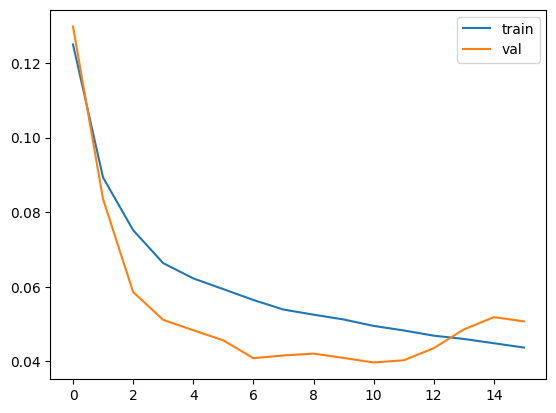

In [531]:
# history = model.fit(train_X, train_y, epochs = 16, batch_size = 32)
history = model.fit(train_X, train_y, epochs=16, batch_size=32, validation_data=(val_X, val_y), shuffle=False) # do not shuffle on time series data

plt.plot(history.history['loss'], label='train')
plt.plot(history.history['val_loss'], label='val')
plt.legend()
plt.show()

Validation

84/84 [==============================] - 1s 2ms/step
(2672, 1)
(2672, 44)


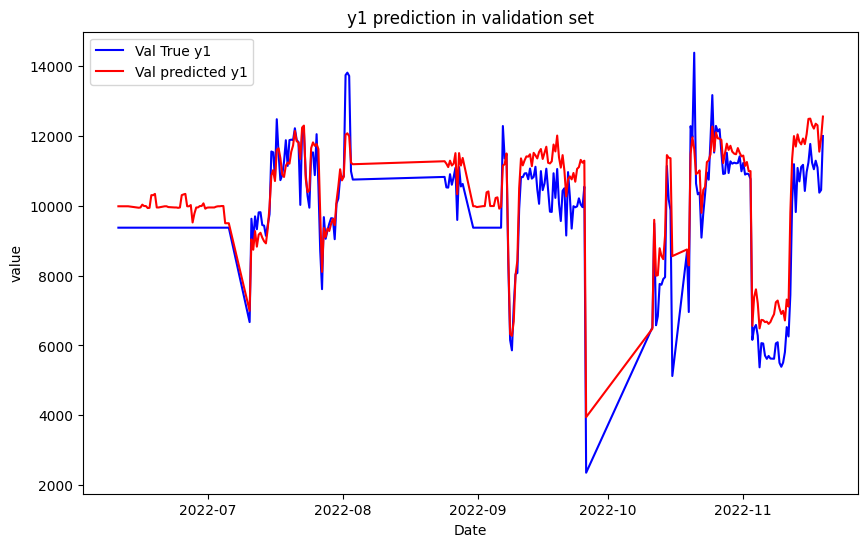

In [532]:
from numpy import concatenate

val_yhat = model.predict(val_X)
print(val_yhat.shape)
val_X1 = val_X.reshape((val_X.shape[0], timesteps*n_features))

# # invert scaling for forecast
# val_yhat = val_yhat.reshape((val_yhat.shape[0], val_yhat.shape[1]))
# val_yhat = val_yhat.reshape((val_yhat.shape[0], 1))
inv_yhat = concatenate((val_yhat, val_X1[:, -(n_features-1):]), axis=1)
inv_yhat = scaler.inverse_transform(inv_yhat)
inv_yhat = inv_yhat[:,0]
# # invert scaling for actual
val_y1 = val_y.reshape((len(val_y), 1))
inv_y = concatenate((val_y1, val_X1[:, -(n_features-1):]), axis=1)
print(inv_y.shape)
inv_y = scaler.inverse_transform(inv_y)
inv_y = inv_y[:,0]

plt.figure(figsize=(10,6))
plt.plot(df['Date'][int(len(X)*0.8):int(len(X)*0.9)][::10], inv_y[::10], color='blue', label='Val True y1')
plt.plot(df['Date'][int(len(X)*0.8):int(len(X)*0.9)][::10], inv_yhat[::10], color='red', label='Val predicted y1')
plt.title('y1 prediction in validation set')
plt.xlabel('Date')
plt.ylabel('value')
plt.legend()
plt.show()

In [533]:
# val_pred = val_pred.reshape((val_pred.shape[0]))

rmse = np.sqrt(mean_squared_error(inv_yhat, inv_y))
print('Validation RMSE: %.3f' % rmse)

Validation RMSE: 848.076


Test

84/84 [==============================] - 0s 2ms/step
(2674, 44)


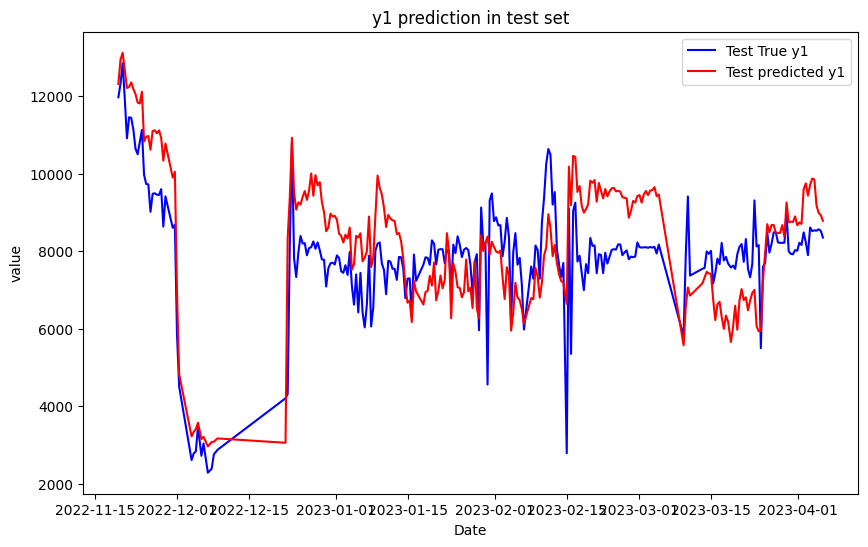

In [534]:
test_yhat = model.predict(test_X)
test_X1 = test_X.reshape((test_X.shape[0], timesteps*n_features))

# # invert scaling for forecast
# test_yhat = test_yhat.reshape((test_yhat.shape[0], test_yhat.shape[1]))
inv_yhat = concatenate((test_yhat, test_X1[:, -(n_features-1):]), axis=1)
inv_yhat = scaler.inverse_transform(inv_yhat)
inv_yhat = inv_yhat[:,0]
# # invert scaling for actual
test_y1 = test_y.reshape((len(test_y), 1))
inv_y = concatenate((test_y1, test_X1[:, -(n_features-1):]), axis=1)
print(inv_y.shape)
inv_y = scaler.inverse_transform(inv_y)
inv_y = inv_y[:,0]

# df_h[['y1']] = scaler_target.inverse_transform(df_h[['y1']])
# y1_test = df_h[['y1']][int(len(df_h)*0.8):]
# predictions = scaler_target.inverse_transform(predictions)
# print(predictions)

plt.figure(figsize=(10,6))
plt.plot(df['Date'][int(len(X)*0.9):int(len(X))][::10], inv_y[::10], color='blue', label='Test True y1')
plt.plot(df['Date'][int(len(X)*0.9):int(len(X))][::10], inv_yhat[::10], color='red', label='Test predicted y1')
plt.title('y1 prediction in test set')
plt.xlabel('Date')
plt.ylabel('value')
plt.legend()
plt.show()

In [535]:
# test_pred = test_pred.reshape((test_pred.shape[0]))

rmse = np.sqrt(mean_squared_error(inv_yhat, inv_y))
print('Test RMSE: %.3f' % rmse)

Test RMSE: 1238.790


#### Timesteps = 1

Data Preparation

In [536]:
timesteps = 1
reframed = series_to_supervised(scaled, timesteps, 1)
print(reframed.head())

   var1(t-1)  var2(t-1)  var3(t-1)  var4(t-1)  var5(t-1)  var6(t-1)   
1   0.509042   0.702033   0.406147   0.000866   0.803311   0.689309  \
2   0.480015   0.700013   0.406123   0.000819   0.803541   0.700020   
3   0.470154   0.699247   0.405081   0.000851   0.803422   0.750483   
4   0.469494   0.697406   0.403733   0.000861   0.803305   0.745570   
5   0.461743   0.694929   0.400987   0.000835   0.803378   0.727481   

   var7(t-1)  var8(t-1)  var9(t-1)  var10(t-1)  ...  var35(t)  var36(t)   
1   0.000556   0.517453        0.0    0.000538  ...  0.912981  0.565807  \
2   0.000551   0.517334        0.0    0.000518  ...  0.912800  0.565425   
3   0.000536   0.517496        0.0    0.000479  ...  0.912643  0.563647   
4   0.000597   0.516680        0.0    0.000467  ...  0.912483  0.561693   
5   0.000549   0.510813        0.0    0.000467  ...  0.912314  0.559728   

   var37(t)  var38(t)  var39(t)  var40(t)  var41(t)  var42(t)  var43(t)   
1  0.934676  0.955512  0.805719  0.948380  0.95

In [537]:
# split into train and test sets
values = reframed.values

train_size = int(0.8 * len(df))
val_size = int(0.1 * len(df))
test_size = len(df) - train_size - val_size

train = values[:train_size, :]
val = values[train_size: train_size + val_size, :]
test = values[-test_size:, :]
# split into input and outputs
# with timesteps=1, we train on var1(t-1) - var44(t-1) to test var1(t)
n_features = 44
n_obs = timesteps * n_features
train_X, train_y = train[:, :n_obs], train[:, -n_features]
val_X, val_y = val[:, :n_obs], val[:, -n_features]
test_X, test_y = test[:, :n_obs], test[:, -n_features]

# reshape input to be 3D [samples, timesteps, features]
train_X = train_X.reshape((train_X.shape[0], timesteps, n_features))
val_X = val_X.reshape((val_X.shape[0], timesteps, n_features))
test_X = test_X.reshape((test_X.shape[0], timesteps, n_features))
print(train_X.shape, train_y.shape, test_X.shape, test_y.shape)

(21383, 1, 44) (21383,) (2674, 1, 44) (2674,)


Train

In [538]:
model = Sequential()
model.add(LSTM(units=32, return_sequences=False, input_shape=(train_X.shape[1], train_X.shape[2]), kernel_regularizer=regularizers.l2(0.001), recurrent_regularizer=regularizers.l2(0.001)))
model.add(Dense(units = 1))
optimizer = keras.optimizers.Adam(lr=0.01)
model.compile(optimizer = optimizer, loss = 'mae')
model.summary()

Model: "sequential_21"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_20 (LSTM)              (None, 32)                9856      
                                                                 
 dense_19 (Dense)            (None, 1)                 33        
                                                                 
Total params: 9,889
Trainable params: 9,889
Non-trainable params: 0
_________________________________________________________________


Epoch 1/16
669/669 [==============================] - 7s 4ms/step - loss: 0.1091 - val_loss: 0.1044
Epoch 2/16
669/669 [==============================] - 2s 3ms/step - loss: 0.0792 - val_loss: 0.0790
Epoch 3/16
669/669 [==============================] - 2s 3ms/step - loss: 0.0700 - val_loss: 0.0652
Epoch 4/16
669/669 [==============================] - 2s 3ms/step - loss: 0.0635 - val_loss: 0.0577
Epoch 5/16
669/669 [==============================] - 2s 3ms/step - loss: 0.0588 - val_loss: 0.0627
Epoch 6/16
669/669 [==============================] - 2s 3ms/step - loss: 0.0561 - val_loss: 0.0690
Epoch 7/16
669/669 [==============================] - 2s 3ms/step - loss: 0.0523 - val_loss: 0.0594
Epoch 8/16
669/669 [==============================] - 2s 3ms/step - loss: 0.0516 - val_loss: 0.0572
Epoch 9/16
669/669 [==============================] - 2s 2ms/step - loss: 0.0494 - val_loss: 0.0613
Epoch 10/16
669/669 [==============================] - 1s 2ms/step - loss: 0.0487 - val_loss: 0.0568

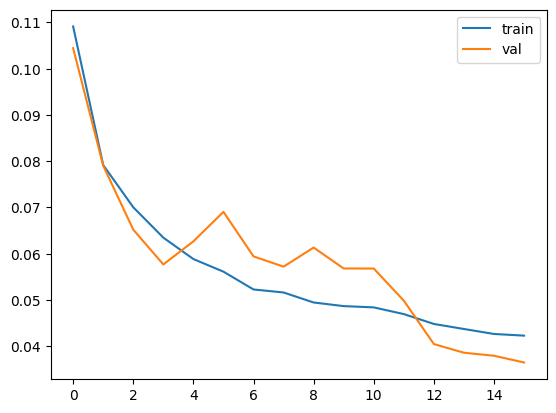

In [539]:
history = model.fit(train_X, train_y, epochs=16, batch_size=32, validation_data=(val_X, val_y), shuffle=False) # do not shuffle on time series data

plt.plot(history.history['loss'], label='train')
plt.plot(history.history['val_loss'], label='val')
plt.legend()
plt.show()

Validation

84/84 [==============================] - 1s 2ms/step
(2672, 1)
(2672, 44)


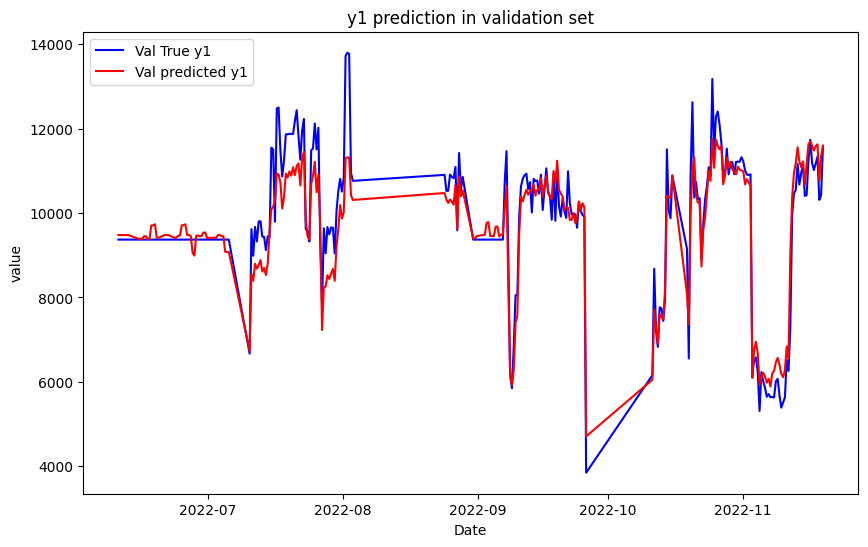

In [540]:
val_yhat = model.predict(val_X)
print(val_yhat.shape)
val_X1 = val_X.reshape((val_X.shape[0], timesteps*n_features))

# # invert scaling for forecast
inv_yhat = concatenate((val_yhat, val_X1[:, -(n_features-1):]), axis=1)
inv_yhat = scaler.inverse_transform(inv_yhat)
inv_yhat = inv_yhat[:,0]
# # invert scaling for actual
val_y1 = val_y.reshape((len(val_y), 1))
inv_y = concatenate((val_y1, val_X1[:, -(n_features-1):]), axis=1)
print(inv_y.shape)
inv_y = scaler.inverse_transform(inv_y)
inv_y = inv_y[:,0]

plt.figure(figsize=(10,6))
plt.plot(df['Date'][int(len(X)*0.8):int(len(X)*0.9)][::10], inv_y[::10], color='blue', label='Val True y1')
plt.plot(df['Date'][int(len(X)*0.8):int(len(X)*0.9)][::10], inv_yhat[::10], color='red', label='Val predicted y1')
plt.title('y1 prediction in validation set')
plt.xlabel('Date')
plt.ylabel('value')
plt.legend()
plt.show()

In [541]:
# val_pred = val_pred.reshape((val_pred.shape[0]))

rmse = np.sqrt(mean_squared_error(inv_yhat, inv_y))
print('Validation RMSE: %.3f' % rmse)

Validation RMSE: 685.472


Test

84/84 [==============================] - 0s 1ms/step
(2674, 44)


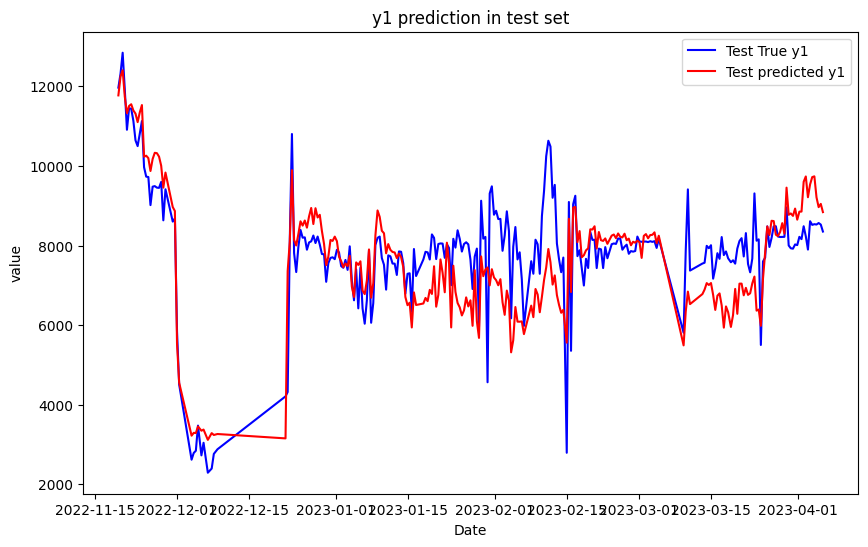

In [542]:
test_yhat = model.predict(test_X)
test_X1 = test_X.reshape((test_X.shape[0], timesteps*n_features))

# # invert scaling for forecast
inv_yhat = concatenate((test_yhat, test_X1[:, -(n_features-1):]), axis=1)
inv_yhat = scaler.inverse_transform(inv_yhat)
inv_yhat = inv_yhat[:,0]
# # invert scaling for actual
test_y1 = test_y.reshape((len(test_y), 1))
inv_y = concatenate((test_y1, test_X1[:, -(n_features-1):]), axis=1)
print(inv_y.shape)
inv_y = scaler.inverse_transform(inv_y)
inv_y = inv_y[:,0]

plt.figure(figsize=(10,6))
plt.plot(df['Date'][int(len(X)*0.9):int(len(X))][::10], inv_y[::10], color='blue', label='Test True y1')
plt.plot(df['Date'][int(len(X)*0.9):int(len(X))][::10], inv_yhat[::10], color='red', label='Test predicted y1')
plt.title('y1 prediction in test set')
plt.xlabel('Date')
plt.ylabel('value')
plt.legend()
plt.show()

In [543]:
rmse = np.sqrt(mean_squared_error(inv_yhat, inv_y))
print('Test RMSE: %.3f' % rmse)

Test RMSE: 1019.487


### XGBoost

In [544]:
from numpy import asarray
from xgboost import XGBRegressor
from sklearn.model_selection import GridSearchCV

In [557]:
timesteps = 1
n_features = 43
reframed = series_to_supervised(scaled, timesteps, 1)
print(reframed.head())

   var1(t-1)  var2(t-1)  var3(t-1)  var4(t-1)  var5(t-1)  var6(t-1)   
1   0.509042   0.702033   0.406147   0.000866   0.803311   0.689309  \
2   0.480015   0.700013   0.406123   0.000819   0.803541   0.700020   
3   0.470154   0.699247   0.405081   0.000851   0.803422   0.750483   
4   0.469494   0.697406   0.403733   0.000861   0.803305   0.745570   
5   0.461743   0.694929   0.400987   0.000835   0.803378   0.727481   

   var7(t-1)  var8(t-1)  var9(t-1)  var10(t-1)  ...  var35(t)  var36(t)   
1   0.000556   0.517453        0.0    0.000538  ...  0.912981  0.565807  \
2   0.000551   0.517334        0.0    0.000518  ...  0.912800  0.565425   
3   0.000536   0.517496        0.0    0.000479  ...  0.912643  0.563647   
4   0.000597   0.516680        0.0    0.000467  ...  0.912483  0.561693   
5   0.000549   0.510813        0.0    0.000467  ...  0.912314  0.559728   

   var37(t)  var38(t)  var39(t)  var40(t)  var41(t)  var42(t)  var43(t)   
1  0.934676  0.955512  0.805719  0.948380  0.95

In [558]:
# split into train and test sets
values = reframed.values

train_size = int(0.8 * len(df))
val_size = int(0.1 * len(df))
test_size = len(df) - train_size - val_size

train = values[:train_size, :]
val = values[train_size: train_size + val_size, :]
test = values[-test_size:, :]

# split into input and outputs
n_obs = timesteps * (n_features+1)
train_X, train_y = train[:, -n_features:], train[:, -(n_features+1)]
val_X, val_y = val[:, -n_features:], val[:, -(n_features+1)]
test_X, test_y = test[:, -n_features:], test[:, -(n_features+1)]

# reshape input to be 3D [samples, timesteps, features]
train_X = train_X.reshape((train_X.shape[0], timesteps, n_features))
val_X = val_X.reshape((val_X.shape[0], timesteps, n_features))
test_X = test_X.reshape((test_X.shape[0], timesteps, n_features))
print(train_X.shape, train_y.shape, test_X.shape, test_y.shape)

(21383, 1, 43) (21383,) (2674, 1, 43) (2674,)


In [559]:
train_X = train_X.reshape((train_X.shape[0], train_X.shape[2]))

Train

In [560]:
# param_grid = {
#     'n_estimators': [50, 100, 200],
#     'max_depth': [5, 7, 9],
#     'learning_rate': [0.01, 0.1, 1]
# }
param_grid = {}

# cv = [(list(range(train_size)), list(range(train_size, train_size + val_size)))]
# cv = (list(range(train_size)))

# print(cv[0][0][-1])
grid_search = GridSearchCV(
    XGBRegressor(colsample_bytree=0.2, gamma=0.0, learning_rate=0.01, max_depth=5, min_child_weight=1.5, n_estimators=7200, reg_alpha=0.9, reg_lambda=0.6, subsample=0.2, random_state=123),
    param_grid=param_grid,
    cv=[(slice(None), slice(None))],
    return_train_score=True
)

grid_result = grid_search.fit(train_X, train_y)

In [561]:
# Get best parameters
best_params = grid_search.best_params_
print(f'Best parameters: {best_params}')

# Get best estimator
best_estimator = grid_search.best_estimator_
print(f'Best estimator: {best_estimator}')

Best parameters: {}
Best estimator: XGBRegressor(base_score=None, booster=None, callbacks=None,
             colsample_bylevel=None, colsample_bynode=None,
             colsample_bytree=0.2, early_stopping_rounds=None,
             enable_categorical=False, eval_metric=None, feature_types=None,
             gamma=0.0, gpu_id=None, grow_policy=None, importance_type=None,
             interaction_constraints=None, learning_rate=0.01, max_bin=None,
             max_cat_threshold=None, max_cat_to_onehot=None,
             max_delta_step=None, max_depth=4, max_leaves=None,
             min_child_weight=1.5, missing=nan, monotone_constraints=None,
             n_estimators=7200, n_jobs=None, num_parallel_tree=None,
             predictor=None, random_state=123, ...)


Top 3 most important features from the trained XGBoost model: ('OXO-5FIC600 Augusta', 'OXO-5FI635C Augusta', 'OXO-5FIC612A Augusta')


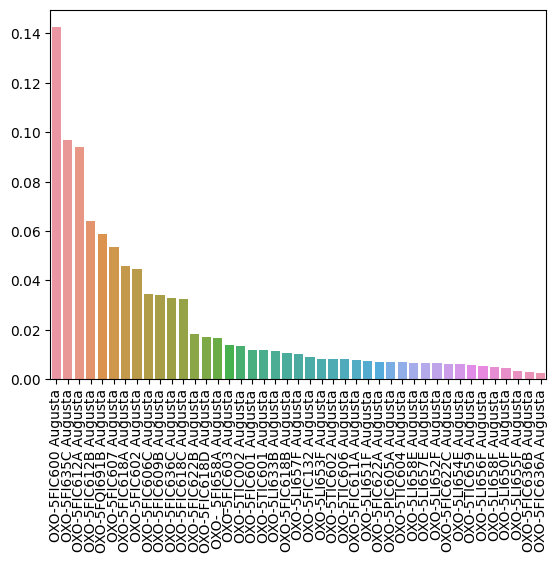

In [562]:
# print(best_estimator.feature_importances_)
feature_names = df_2.columns[1:]
feat_imps = zip(feature_names, best_estimator.feature_importances_)
feats, imps = zip(*(sorted(list(filter(lambda x: x[1] != 0, feat_imps)), key=lambda x: x[1], reverse=True)))
ax = sns.barplot(x=list(feats), y=list(imps))
ax.tick_params(axis='x', rotation=90)
print('Top 3 most important features from the trained XGBoost model:', feats[:3])

Validation

In [563]:
val_X = val_X.reshape((val_X.shape[0], val_X.shape[2]))
val_X.shape

(2672, 43)

(2672,)
(2672, 43)
(2672, 44)


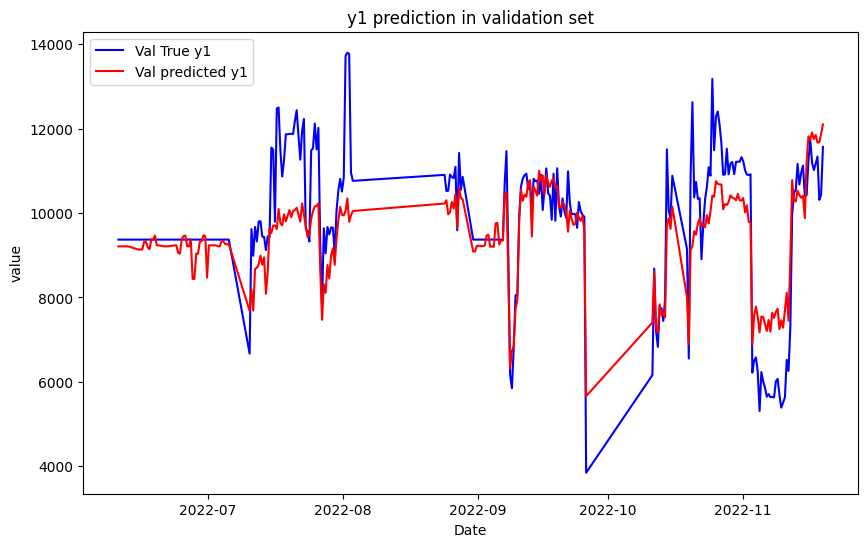

In [564]:
val_yhat = grid_search.predict(val_X)
print(val_yhat.shape)
val_X1 = val_X.reshape((val_X.shape[0], timesteps*(n_features)))
print(val_X1.shape)

# # invert scaling for forecast
# val_yhat = val_yhat.reshape((val_yhat.shape[0], val_yhat.shape[1]))
val_yhat = val_yhat.reshape((val_yhat.shape[0], 1))
inv_yhat = concatenate((val_yhat, val_X1), axis=1)
inv_yhat = scaler.inverse_transform(inv_yhat)
inv_yhat = inv_yhat[:,0]
# # invert scaling for actual
val_y1 = val_y.reshape((len(val_y), 1))
inv_y = concatenate((val_y1, val_X1), axis=1)
print(inv_y.shape)
inv_y = scaler.inverse_transform(inv_y)
inv_y = inv_y[:,0]

plt.figure(figsize=(10,6))
plt.plot(df['Date'][int(len(X)*0.8):int(len(X)*0.9)][::10], inv_y[::10], color='blue', label='Val True y1')
plt.plot(df['Date'][int(len(X)*0.8):int(len(X)*0.9)][::10], inv_yhat[::10], color='red', label='Val predicted y1')
plt.title('y1 prediction in validation set')
plt.xlabel('Date')
plt.ylabel('value')
plt.legend()
plt.show()

In [565]:
rmse = np.sqrt(mean_squared_error(inv_yhat, inv_y))
print('Validation RMSE: %.3f' % rmse)

Validation RMSE: 1101.343


Test

In [566]:
test_X = test_X.reshape((test_X.shape[0], test_X.shape[2]))
test_X.shape

(2674, 43)

(2674,)
(2674, 43)
(2674, 44)


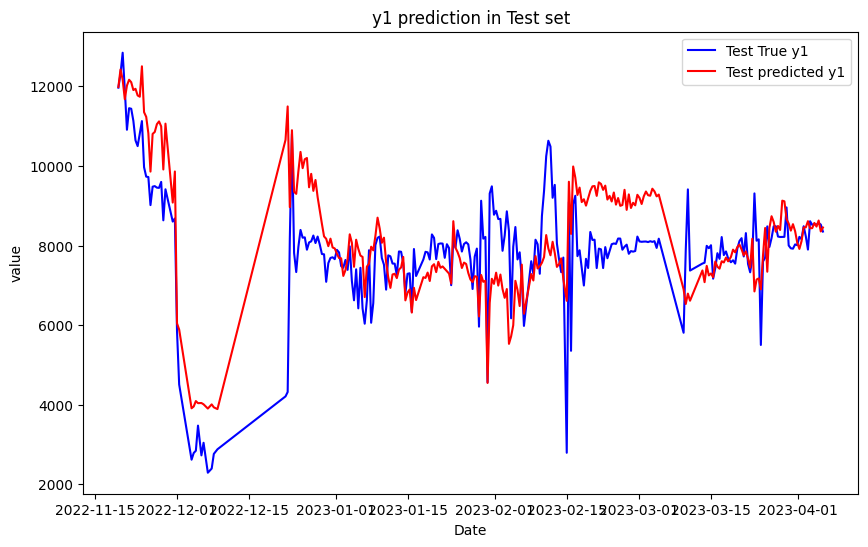

In [567]:
test_yhat = grid_search.predict(test_X)
print(test_yhat.shape)
test_X1 = test_X.reshape((test_X.shape[0], timesteps*(n_features)))
print(test_X1.shape)

# # invert scaling for forecast
test_yhat = test_yhat.reshape((test_yhat.shape[0], 1))
inv_yhat = concatenate((test_yhat, test_X1), axis=1)
inv_yhat = scaler.inverse_transform(inv_yhat)
inv_yhat = inv_yhat[:,0]
# # invert scaling for actual
test_y1 = test_y.reshape((len(test_y), 1))
inv_y = concatenate((test_y1, test_X1), axis=1)
print(inv_y.shape)
inv_y = scaler.inverse_transform(inv_y)
inv_y = inv_y[:,0]

plt.figure(figsize=(10,6))
plt.plot(df['Date'][int(len(X)*0.9):][::10], inv_y[::10], color='blue', label='Test True y1')
plt.plot(df['Date'][int(len(X)*0.9):][::10], inv_yhat[::10], color='red', label='Test predicted y1')
plt.title('y1 prediction in Test set')
plt.xlabel('Date')
plt.ylabel('value')
plt.legend()
plt.show()

In [568]:
rmse = np.sqrt(mean_squared_error(inv_yhat, inv_y))
print('Test RMSE: %.3f' % rmse)

Test RMSE: 1175.320
